In [1]:
import os
import numpy as np
import pandas as pd
import time, pickle, h5py, sys 
import itertools
from itertools import product
from collections import defaultdict

from chemicalchecker import ChemicalChecker
from chemicalchecker.core import DataSignature
from chemicalchecker.core import signature_base
from chemicalchecker.core import Molset
from gensim.models import KeyedVectors
from IPython import display
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

from scipy.spatial.distance import euclidean, cosine
from sklearn.neighbors import NearestNeighbors

import warnings
warnings.filterwarnings("ignore")

https://gitlabsbnb.irbbarcelona.org/project/CC_protocols/-/blob/master/MICROBIOTA/notebooks/MICROBIOTA_binary.ipynb

https://gitlabsbnb.irbbarcelona.org/project/CC_protocols/-/blob/master/MICROBIOTA/data/microbiota_raw.csv

In [2]:
# instantiate class
cc = ChemicalChecker('/aloy/web_checker/current/')
cc.set_verbosity('INFO') # suppress debug ouput 

[INFO    ] Logging level INFO for logger 'chemicalchecker'.


In [3]:
cc.cc_root

'/aloy/web_checker/package_cc/2021_07'

In [4]:
# create a local copy of CC with all symlinks to the models 
import_sign_dir = os.path.join(cc.cc_root, "sign_model_links")
cc_local_root = './cc_local'
cc_local = ChemicalChecker(cc_local_root, custom_data_path=import_sign_dir)
cc_local.cc_root

[INFO    ] CC root directory exists: ignoring 'custom_data_path'.


'/aloy/home/eviesi/APDB_space/cc_local'

In [5]:
# load APDB molecules
MOLECULE_PATH = "/aloy/home/eviesi/datasets/tables/MoleculesTable.csv"
apdb_df = pd.read_csv(MOLECULE_PATH, encoding = 'latin1')
apdb_smiles = apdb_df["Canonical_SMILES"].to_list()
apdb_inchikeys = apdb_df["InChIKey"].to_list()
print("Nº of SMILES is %d" %( len(apdb_smiles) ))

Nº of SMILES is 1830


### New FPB/F1 space

In [6]:
# define variables
CC_SPACE = "F"
DATASET = "F1.001"

In [7]:
# create dataframe with inchikey as index and continuous features as columns (as A5, D2 & D4 in CC)
# fpb_df = pd.DataFrame(models_list[0].values())
# # set column names
# names = list(itertools.repeat("FPB", times=fpb_df.shape[1]))
# fpb_df.columns = [i + j for i, j in zip(names, list(map(str, range(fpb_df.shape[1]))))]
# # insert inchikeys as first column
# fpb_df.insert(0, 'InChIKey', [k[0] for k in models_list[0].keys()])
# fpb_df

In [6]:
# load FPB table
DATA_PATH = "/aloy/home/eviesi/datasets/tables/FPBitsTable.csv"
fpb_df = pd.read_csv(DATA_PATH)
fpb_df.rename(columns={"Unnamed: 0" : "CID"}, inplace=True)
fpb_df.head()

,CID,FP1,FP2,FP3,FP4,FP5,FP6,FP7,FP8,FP9,...,AD2D714,AD2D715,AD2D726,AD2D729,AD2D735,AD2D760,AD2D765,AD2D766,AD2D770,AD2D780
0,8680,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,143127,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,10870,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,69848,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,12993,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [44]:
# add inchikey 
fpb_df = pd.merge(apdb_df[['CID', 'InChIKey']], fpb_df, on='CID').set_index('CID')
# take only a subset
#fpb_df = fpb_df.iloc[0:50]
len(fpb_df)

1826

In [9]:
# get data 
features = fpb_df.columns[1:]
keys = fpb_df.InChIKey.to_list()
X = fpb_df[features].values
X.shape

(1826, 5305)

In [10]:
# range of values (BINARY features) 
print(X.min().min(), X.max().max())

0 1


In [116]:
# plot correlation
corr = fpb_df.corr()
mask = np.zeros_like(corr, dtype=bool)
mask[np.triu_indices_from(mask)] = True
corr[mask] = np.nan
(corr
 .style
 .background_gradient(cmap='coolwarm', axis=None, vmin=-1, vmax=1)
 .highlight_null(null_color='#f1f1f1')  # Color NaNs grey
 .set_precision(2))


### sign0: raw data

In [22]:
# create path to sign0
sign0 = cc_local.signature(DATASET,'sign0')
sign0.clear_all()
# fit sign0 
sign0.fit(X=X, keys=keys, features=features, validations=False, overwrite=True) 

[INFO    ] STATUS: FIT START
[INFO    ] STATUS: Getting data
[INFO    ] Initial keys: 1826 / Final keys: 1826
[INFO    ] STATUS: Sanitizing
Iterating on `V` axis 1: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.68it/s]
[INFO    ] Filter 1383 features (min_feature_abs): ['AD2D100' 'AD2D101' 'AD2D105' ... 'SubFP74' 'SubFP75' 'SubFP76']
[INFO    ] Filter 36 features (max_feature_freq): ['AD2D1' 'AD2D157' 'AD2D79' 'ExtFP809' 'ExtFP847' 'ExtFP907' 'ExtFP950'
 'ExtFP996' 'FP638' 'FP742' 'FP743' 'FP921' 'FP972' 'GraphFP500'
 'GraphFP504' 'GraphFP531' 'GraphFP596' 'GraphFP742' 'GraphFP743'
 'GraphFP859' 'GraphFP860' 'GraphFP928' 'GraphFP941' 'KRFP2975'
 'MACCSFP112' 'MACCSFP22' 'PubchemFP0' 'PubchemFP10' 'PubchemFP283'
 'PubchemFP284' 'PubchemFP332' 'PubchemFP344' 'PubchemFP9' 'SubFP300'
 'SubFP301' 'SubFP307']
Iterating on `V` axis 0: 100%|██████████████████████

In [23]:
sign0.shape

(1826, 3886)

In [24]:
# any nan or infinite value? 
print(np.isnan(sign0.data).sum(), np.isinf(sign0.data).sum())

0 0


In [25]:
# look at the reference dataset
sign0_ref = cc_local.get_signature('sign0', 'reference', DATASET)
sign0_ref.shape
# redundant keys 

(1667, 3886)

#### Neighbors are computed in the reference space

In [10]:
# compute neighbors (fit will be done with the reference sign0)
neig0 = cc_local.signature(DATASET, 'neig0')
neig0.clear_all()
neig0.fit(sign0)
neig0.shape
# neighbors/bg distances = 1000 

[INFO    ] Loading faiss with AVX2 support.
[INFO    ] Successfully loaded faiss with AVX2 support.


array([1826, 1000])

In [11]:
neig0 = cc_local.get_signature('neig0', 'reference', DATASET)
neig0.shape

array([1667, 1000])

In [10]:
# compute neighbors (fit will be done with the reference neig0)
neig0 = cc_local.get_signature('neig0', 'reference', DATASET)
neig0.clear_all()
neig0.fit(sign0)
neig0.shape

array([1667, 1000])

In [11]:
neig0 = cc_local.get_signature('neig0', 'full', DATASET)
neig0.shape

array([1826, 1000])

In [12]:
# ref_cctype (string): the reference for the diagnostics is sign0 (by default)
sign0 = cc_local.signature(DATASET, 'sign0')
diag0 = sign0.diagnosis(ref_cctype='sign0')

In [76]:
# entire plot
diag0.canvas(size='medium', savefig=True, savefig_kwargs={'dpi': 600, 'facecolor': 'white'})

In [78]:
display.Image("/aloy/home/eviesi/APDB_space/cc_local/full/F/F1/F1.001/sign0/diags/cc_local_sign0/F1.001_sign0_cc_local_sign0_medium.png")
# look at TSNE plot ->  good clusters and separation
# good distribution of euclidean and cosine distances (no strange spikes)
# good coverage, in particular for chemistry data
# good ROC-AUC for A spaces 

In [79]:
# canvas plot deciding which plots to do and the resolution 
diag0.canvas(size='medium', savefig=True,  savefig_kwargs={'dpi': 600, 'facecolor': 'white'}, 
             dest_dir='/aloy/home/eviesi/plots/APDB_spaces_plots',
             skip_plots=['redundancy', 'intensities', 'intensities_projection', 'key_coverage', 'key_coverage_projection', 
                         'confidences', 'confidences_projection', 'cluster_sizes', 'clusters_projection', 
                         'outliers',  'global_ranks_agreement', 'global_ranks_agreement_projection', 'values']) 

In [80]:
display.Image("/aloy/home/eviesi/plots/APDB_spaces_plots/F1.001_sign0_cc_local_sign0_medium.png")

### sign1: compression of the sign0 with a dimensionality typically retaining 90% of the original variance

In [28]:
# create path to sign1 
sign1 = cc_local.signature(DATASET, 'sign1')
sign1.clear_all()
# # fit sign1
sign1.fit(sign0, overwrite=True, validations=False, metric_learning=False)

2023-05-09 14:32:18.386664: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0
[INFO    ] STATUS: FIT START
[INFO    ] STATUS: Getting data
[INFO    ] STATUS: LSI
[INFO    ] Generating dictionary.
[INFO    ] min_freq: 5
[INFO    ] max_freq: 0.25
[INFO    ] Fitting LSI model.
[INFO    ] num_topics: 2448
[WARNING ] Dropped 3 molecules (only zeros).
[WARNING ] Dropped 3 molecules (only zeros).
[INFO    ] STATUS: Background distances
[INFO    ] Background distances not available, computing them.
[INFO    ] Background distances sample_pairs: 97506
[INFO    ] Background distances not available, computing them.
[INFO    ] Background distances sample_pairs: 97506
[INFO    ] STATUS: FIT END


In [29]:
# no significant decrease in keys and features 
sign1.shape 

(1823, 312)

In [30]:
# any nan or infinite value? 
print(np.isnan(sign1.data).sum(), np.isinf(sign1.data).sum())

0 0


In [31]:
# look at the reference dataset
sign1_ref = cc_local.get_signature('sign1', 'reference', DATASET)
sign1_ref.shape
# some redundant keys 

(1664, 312)

In [18]:
# canvas plot
sign1 = cc_local.signature(DATASET, 'sign1')
diag1 = sign1.diagnosis()

In [84]:
# entire plot
diag1.canvas(size='medium', savefig=True, savefig_kwargs={'dpi': 600, 'facecolor': 'white'})

In [85]:
display.Image("/aloy/home/eviesi/APDB_space/cc_local/full/F/F1/F1.001/sign1/diags/cc_local_sign0/F1.001_sign1_cc_local_sign0_medium.png")

In [82]:
# canvas plot deciding which plots to do and the resolution 
diag1.canvas(size='medium', savefig=True,  savefig_kwargs={'dpi': 600, 'facecolor': 'white'}, 
             dest_dir='/aloy/home/eviesi/plots/APDB_spaces_plots',
             skip_plots=['redundancy', 'intensities', 'intensities_projection', 'key_coverage', 'key_coverage_projection', 
                         'confidences', 'confidences_projection', 'cluster_sizes', 'clusters_projection', 
                         'outliers',  'global_ranks_agreement', 'global_ranks_agreement_projection', 'values']) 

In [83]:
display.Image("/aloy/home/eviesi/plots/APDB_spaces_plots/F1.001_sign1_cc_local_sign0_medium.png")

In [34]:
# compute neighbors (fit will be done with the reference neig1)
neig1 = cc_local.signature(DATASET, 'neig1')
neig1.clear_all()
neig1.fit(sign1)

In [7]:
neig1 = cc_local.signature(DATASET, 'neig1')
neig1.shape

array([1823, 1000])

### sign2: network embedding of the similarity matrix derived from sign1

These signatures are the result of a two-step process:
1. Transforming nearest-neighbor of signature type 1 to graph.
2. Performing network embedding with Node2Vec.

In [35]:
# create path to sign2
sign2 = cc_local.signature(DATASET, 'sign2')
sign2.clear_all()
# # fit sign2
sign2.fit(sign1, neig1, oos_predictor=False, overwrite=True, validations=False)

[WARNING ] From /opt/miniconda3/envs/py37/lib/python3.7/site-packages/adanet/core/tpu_estimator.py:33: The name tf.estimator.tpu.TPUEstimator is deprecated. Please use tf.compat.v1.estimator.tpu.TPUEstimator instead.

[INFO    ] STATUS: FIT START
[INFO    ] STATUS: Node2Vec
[INFO    ] Reading bg_distances file for metric: cosine
[INFO    ] Nodes :         1664
[INFO    ] Edges :        55859
[INFO    ] -i:/aloy/home/eviesi/APDB_space/cc_local/reference/F/F1/F1.001/sign2/models/node2vec/graph.edgelist -o:/aloy/home/eviesi/APDB_space/cc_local/reference/F/F1/F1.001/sign2/models/node2vec/n2v.emb -d:128 -l:80 -r:10 -k:10 -e:1 -p:1 -q:1 -v -w
[INFO    ] cpu: 1
[INFO    ] Converting /aloy/home/eviesi/APDB_space/cc_local/reference/F/F1/F1.001/sign2/models/node2vec/n2v.emb to /aloy/home/eviesi/APDB_space/cc_local/reference/F/F1/F1.001/sign2/sign2.h5
[INFO    ] words: 1664 features: 128
100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████

In [36]:
sign2.shape

(1823, 128)

In [37]:
# any nan or infinite value? 
print(np.isnan(sign2.data).sum(), np.isinf(sign2.data).sum())

0 0


In [38]:
# look at the reference dataset
sign2_ref = cc_local.get_signature('sign2', 'reference', DATASET)
sign2_ref.shape
# 128 embedding dimension

(1664, 128)

In [21]:
# canvas plot
sign2 = cc_local.signature(DATASET, 'sign2')
diag2 = sign2.diagnosis()

In [87]:
# entire plot
diag2.canvas(size='medium', savefig=True, savefig_kwargs={'dpi': 600, 'facecolor': 'white'})

In [88]:
display.Image("/aloy/home/eviesi/APDB_space/cc_local/full/F/F1/F1.001/sign2/diags/cc_local_sign0/F1.001_sign2_cc_local_sign0_medium.png")

In [89]:
# canvas plot deciding which plots to do and the resolution 
diag2.canvas(size='medium', savefig=True,  savefig_kwargs={'dpi': 600, 'facecolor': 'white'}, 
             dest_dir='/aloy/home/eviesi/plots/APDB_spaces_plots',
             skip_plots=['redundancy', 'intensities', 'intensities_projection', 'key_coverage', 'key_coverage_projection', 
                         'confidences', 'confidences_projection', 'cluster_sizes', 'clusters_projection', 
                         'outliers',  'global_ranks_agreement', 'global_ranks_agreement_projection', 'values']) 

In [90]:
display.Image("/aloy/home/eviesi/plots/APDB_spaces_plots/F1.001_sign2_cc_local_sign0_medium.png")

In [41]:
# compute neighbors (fit will be done with the reference neig2)
neig2 = cc_local.signature(DATASET, 'neig2')
neig2.clear_all()
neig2.fit(sign2)

In [10]:
neig2 = cc_local.signature(DATASET, 'neig2')
neig2_ref = cc_local.get_signature('neig2', 'reference', DATASET)
print(neig2.shape, neig2_ref.shape)

[1823 1000] [1664 1000]


<AxesSubplot:title={'center':'AUROC (0.982)'}, xlabel='FPR', ylabel='TPR'>

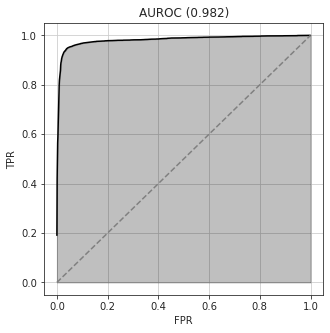

In [7]:
sign2 = cc_local.signature(DATASET, 'sign2')
diag2 = sign2.diagnosis(ref_cctype='sign0')
diag2.roc(DATASET, 'sign0', plot=True, save=False)

### sign3: fixed-length representation of the data capturing and inferring the original (sign1) similarity of the data

In [7]:
# get sign1
sign1 = cc_local.signature(DATASET, 'sign1')
sign1.shape

(1823, 312)

In [8]:
# get sign2
sign2 = cc_local.signature(DATASET, 'sign2')
sign2.shape

(1823, 128)

In [44]:
# molecule overlap with the CC universe
print("Number of molecules in CC universe:", len(cc_local.universe))

[WARNING ] Data file /aloy/home/eviesi/APDB_space/cc_local/full/B/B2/B2.002/sign0/sign0.h5 not available.


Number of molecules in CC universe: 1009262


In [45]:
# make a balance of CC and APDB data -> take 50% of CC to fit
fpb_inchikeys = sign2.keys
print("Length of our inchikeys: ",len(set(fpb_inchikeys)))
print("Intersection between our inchikeys and CC universe is: ", len(set(fpb_inchikeys).intersection(cc_local.universe)))

Length of our inchikeys:  1823
Intersection between our inchikeys and CC universe is:  916


In [46]:
 # initialization of sign3
sign3 = cc_local.signature(DATASET, 'sign3')
# cleaning up sign3 full and sign3 reference file directories
sign3.clear_all()

In [47]:
# Create a list of sign2 to feed sign3: 
# using the 25 CC spaces + the new custom space
sign2_list = [cc_local.signature(ds, 'sign2') for ds in cc_local.datasets_exemplary()]
sign2_list.append(sign2)
len(sign2_list)  # 26 spaces 

26

In [48]:
# fit sign3 in cluster 
# skip applicability calculation with model_confidence=False because too uniform (no stdev)
sign3.fit_hpc(sign2_list, sign2, sign1, None, 'fast', None, cpu=32, model_confidence=False)
# sign3.fit(sign2_list, sign2, sign1)

[INFO    ] Writing file /aloy/scratch/eviesi/tmp_jobs/CC_SIGN3_F1.001_fit__ado05nbl/job-CC_SIGN3_F1.001_fit__.sh...


### sign3 analysis

In [8]:
# get sign3
sign3 = cc_local.signature(DATASET, 'sign3')
sign3.shape

(1010200, 128)

[INFO    ] Loading faiss with AVX2 support.
[INFO    ] Successfully loaded faiss with AVX2 support.
[INFO    ] Removing near duplicates.
[INFO    ] Size before removing: 1010200
[INFO    ] Size after removing: 987421


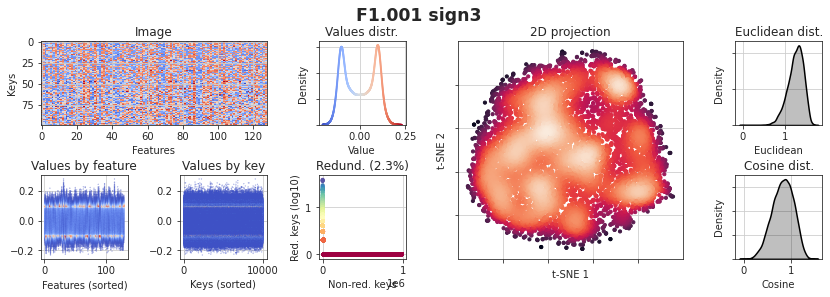

In [21]:
diag3 = sign3.diagnosis()
diag3.canvas_small()

In [67]:
# canvas plot
# difference in MoA/recapitulation between sign2 and sign3 can be do to the fact that Checker influences more predictions  
sign3 = cc_local.signature(DATASET, 'sign3')
diag3 = sign3.diagnosis()

In [94]:
# entire plot
diag3.canvas(size='medium', savefig=True, savefig_kwargs={'dpi': 600, 'facecolor': 'white'})

In [95]:
display.Image("/aloy/home/eviesi/APDB_space/cc_local/full/F/F1/F1.001/sign3/diags/cc_local_sign0/F1.001_sign3_cc_local_sign0_medium.png")

In [92]:
# canvas plot deciding which plots to do and the resolution 
diag3.canvas(size='medium', savefig=True,  savefig_kwargs={'dpi': 600, 'facecolor': 'white'}, 
             dest_dir='/aloy/home/eviesi/plots/APDB_spaces_plots',
             skip_plots=['redundancy', 'intensities', 'intensities_projection', 'key_coverage', 'key_coverage_projection', 
                         'confidences', 'confidences_projection', 'cluster_sizes', 'clusters_projection', 
                         'outliers',  'global_ranks_agreement', 'global_ranks_agreement_projection', 'values']) 

In [93]:
display.Image("/aloy/home/eviesi/plots/APDB_spaces_plots/F1.001_sign3_cc_local_sign0_medium.png")

<AxesSubplot:title={'center':'F1.001_sign3_full | F1.001_sign0_full (0.921)'}, xlabel='FPR', ylabel='TPR'>

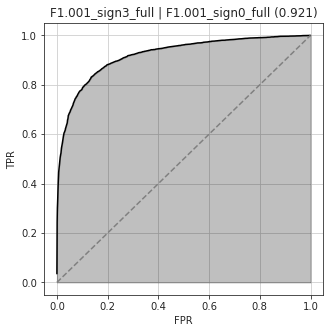

In [68]:
# recapitulation of sign0
diag3.cross_roc(sign0, save=True, plot=True)

In [69]:
# open the image to change color and save 
cross_roc = open('/aloy/home/eviesi/APDB_space/cc_local/full/F/F1/F1.001/sign3/diags/cc_local_sign0/cross_roc_F1.001_sign0_full.pkl', 'rb')
results = pickle.load(cross_roc)
results

{'fpr': array([0.        , 0.        , 0.        , ..., 0.99850523, 0.99850523,
        1.        ]),
 'tpr': array([0.00000000e+00, 2.71776057e-04, 1.08710423e-03, ...,
        9.99864112e-01, 1.00000000e+00, 1.00000000e+00]),
 'auc': 0.9206810278098478,
 'precision': array([0.50037397, 0.50034   , 0.50037402, ..., 1.        , 1.        ,
        1.        ]),
 'recall': array([1.00000000e+00, 9.99864112e-01, 9.99864112e-01, ...,
        4.07664085e-04, 2.71776057e-04, 0.00000000e+00]),
 'average_precision_score': 0.9293851963218542}

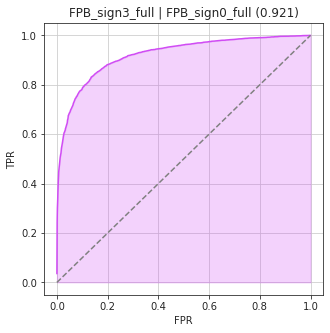

In [70]:
# save results 
alpha=0.25
step = 0.001

fig, ax = plt.subplots(1, 1, figsize=(5, 5))
fpr = np.arange(0, 1 + step, step)
tpr = np.interp(fpr, results["fpr"], results["tpr"])
color = "#d04cf4"
ax.plot(fpr, tpr, color=color)
ax.plot([0, 1], [0, 1], color="gray", linestyle="--")
ax.fill_between(fpr, tpr, color=color, alpha=alpha)
ax.set_xlim(-0.05, 1.05)
ax.set_ylim(-0.05, 1.05)
ax.set_xlabel("FPR")
ax.set_ylabel("TPR")
ax.set_title("FPB_sign3_full | FPB_sign0_full (" + str(round(results['auc'],3)) + ")")
plt.savefig('/aloy/home/eviesi/plots/APDB_spaces_plots/cross_roc_F1_sign3_sign0_full', dpi=600)

<AxesSubplot:ylabel='Count'>

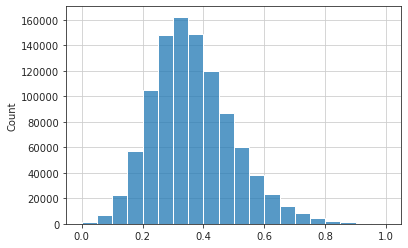

In [9]:
# get applicability and plot distribution
apps = sign3.get_h5_dataset('applicability')
sns.histplot(apps, binrange=(0,1), binwidth=0.05)

In [10]:
# how many with applicability higher than 0.75?
sum(apps>0.75)

8655

In [96]:
# get known predictions in sign0
known = sign3.get_h5_dataset('known')
sign3_s0 = sign3[:][known]
sign3_s0.shape

(1823, 128)

In [25]:
sign3.info_h5

{'V': (1010200, 128),
 'applicability': (1010200,),
 'confidence': (1010200,),
 'datasets': (26,),
 'keys': (1010200,),
 'known': (1010200,),
 'prior': (1010200,),
 'prior_signature': (1010200,),
 'robustness': (1010200,),
 'shape': (2,)}

### sign4
Since not all sign0 molecules are in the CC we need to provide a MFP sign0 with all molecules relevant for training.

This should be the union of the CC A1 and the A1 generated when fitting sign3

In [10]:
# get F1 sign0
sign0 = cc_local.signature(DATASET, 'sign0')
sign0.shape

(1826, 3886)

In [11]:
# look at fingerprints features 
sign0.get_h5_dataset('features')

array(['AD2D102', 'AD2D103', 'AD2D106', ..., 'SubFP9', 'SubFP96',
       'SubFP99'], dtype='<U12')

In [12]:
# get F1 sign3
sign3 = cc_local.signature(DATASET, 'sign3')
sign3.shape

(1010200, 128)

In [13]:
# check if all molecules are in sign3 (getting back the 3 lost molecules in sign1 because they were in the CC) 
len(list(set(sign0.keys) & set(sign3.keys)))

1826

In [21]:
# get A1 sign0 generated when fitting sign3 (since not all molecules are in the CC)
# A1: 2D fingerprints. The 2,048-bit Morgan fingerprints (radius of 2) from RDKIT
cc_extra = ChemicalChecker(os.path.join(sign3.model_path,'tmp_cc'))
sign0_extra_F1 = cc_extra.signature('A1.001', 'sign0')
sign0_extra_F1.shape  # added MFP of 907 molecules 

(907, 2048)

In [22]:
# get MFP (sign0 in A1)
sign0_A1 = cc_local.signature('A1.001', 'sign0')
sign0_A1.shape

(1009293, 2048)

In [15]:
# no common molecules between A1 CC and A1 extra 
set(sign0_A1.keys) & set(sign0_extra_F1.keys)

set()

In [16]:
# merge sign0 A1 with sign0_extra F1 in a new A space
sign0_merge = cc_local.signature('A1.002', 'sign0')
sign0_merge.clear_all() 
DataSignature.vstack_signatures([sign0_A1, sign0_extra_F1], sign0_merge.data_path, chunk_size=10000, vchunk_size=1024)

reordering rows: 100%|███████████████████████████████████████████████████████████████████| 2/2 [07:58<00:00, 239.01s/it]


In [17]:
sign0_merge = cc_local.signature('A1.002', 'sign0')
sign0_merge.shape

(1010200, 2048)

In [19]:
sign0_merge.copy_from(sign0_A1, 'features')   # 2048 MFP
sign0_merge.info_h5

{'V': (1010200, 2048), 'features': (2048,), 'keys': (1010200,)}

In [20]:
# check if all APDB molecules are in sign0 merge
len(list(set(sign0.keys) & set(sign0_merge.keys)))

1826

In [35]:
# check if the order of the keys in sign0 merge and sign3 is the same
list(sign0_merge.keys) == list(sign3.keys)

True

In [27]:
sign4 = cc_local.signature(DATASET, 'sign4')
# sign4.clear_all()
# this method is fitting a model that uses Morgan fingerprint as features to predict signature 3
#sign4.fit_hpc(sign0_merge, sign3, None, True, False, cpu=32)
sign4.shape

(1010200, 128)

In [97]:
# look at canvas
diag4 = sign4.diagnosis()

In [99]:
# entire plot
diag4.canvas(size='medium', savefig=True, savefig_kwargs={'dpi': 600, 'facecolor': 'white'})

In [100]:
display.Image("/aloy/home/eviesi/APDB_space/cc_local/full/F/F1/F1.001/sign4/diags/cc_local_sign0/F1.001_sign4_cc_local_sign0_medium.png")

In [101]:
# canvas plot deciding which plots to do and the resolution 
diag4.canvas(size='medium', savefig=True,  savefig_kwargs={'dpi': 600, 'facecolor': 'white'}, 
             dest_dir='/aloy/home/eviesi/plots/APDB_spaces_plots',
             skip_plots=['redundancy', 'intensities', 'intensities_projection', 'key_coverage', 'key_coverage_projection', 
                         'confidences', 'confidences_projection', 'cluster_sizes', 'clusters_projection', 
                         'outliers',  'global_ranks_agreement', 'global_ranks_agreement_projection', 'values']) 

In [102]:
display.Image("/aloy/home/eviesi/plots/APDB_spaces_plots/F1.001_sign4_cc_local_sign0_medium.png")

In [104]:
# compare with sign4 of A1 and A2 and B4 (the best recapitulation)
sign4_A1 = cc_local.signature('A1.001', 'sign4')
sign4_A1.shape

(1009293, 128)

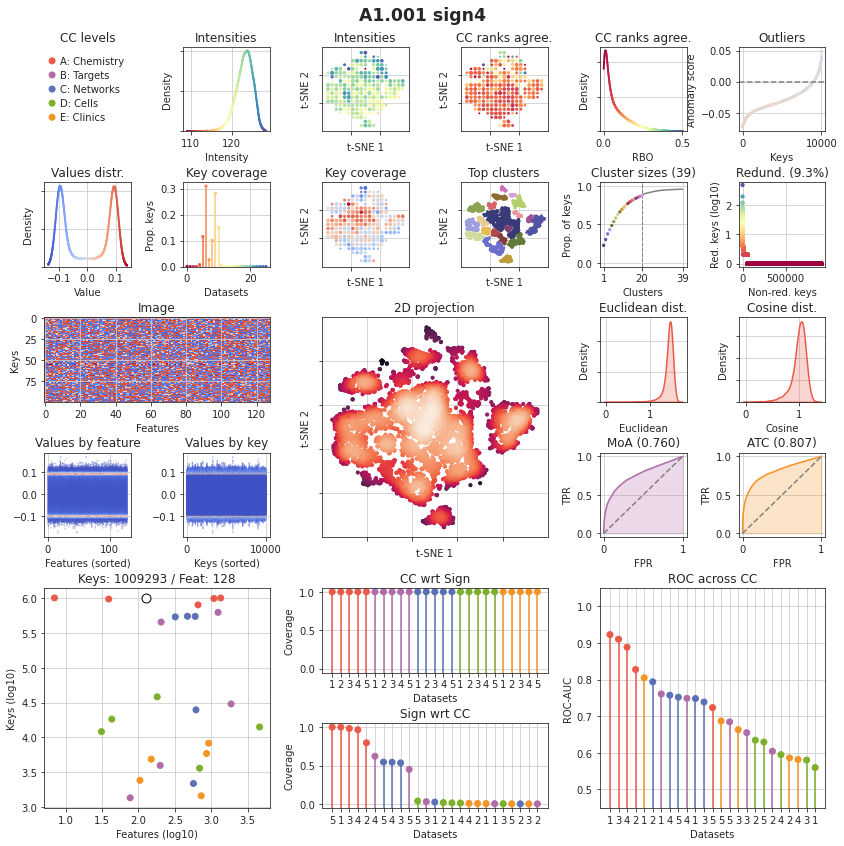

In [105]:
diag4_A1 = sign4_A1.diagnosis()
diag4_A1.canvas_medium()

In [17]:
# compare with sign4 of A1 and A2 and B4 (the best recapitulation)
sign4_B4 = cc_local.signature('B4.001', 'sign4')
sign4_B4.shape

(1009293, 128)

[INFO    ] Loading faiss with AVX2 support.
[INFO    ] Successfully loaded faiss with AVX2 support.
[INFO    ] Removing near duplicates.
[INFO    ] Size before removing: 1009293
[INFO    ] Size after removing: 766408


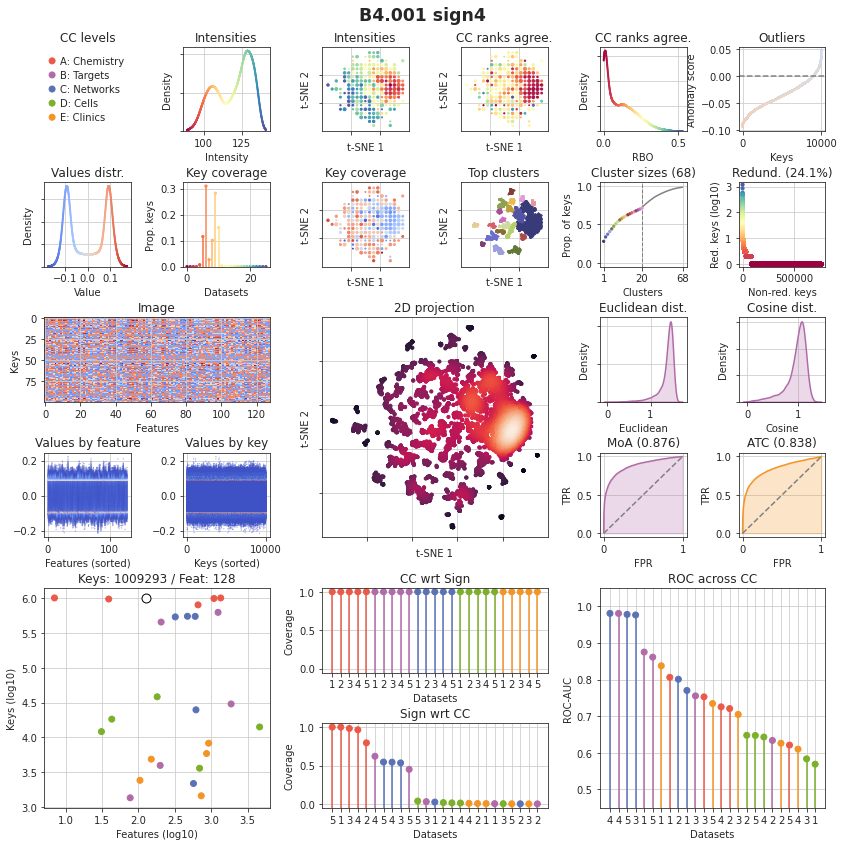

In [18]:
diag4_B4 = sign4_B4.diagnosis()
diag4_B4.canvas_medium()

In [39]:
# get sign0
sign0 = cc_local.signature(DATASET, 'sign0')
sign0.shape

(1826, 3886)

<AxesSubplot:title={'center':'F1.001_sign4_full | F1.001_sign0_full (0.944)'}, xlabel='FPR', ylabel='TPR'>

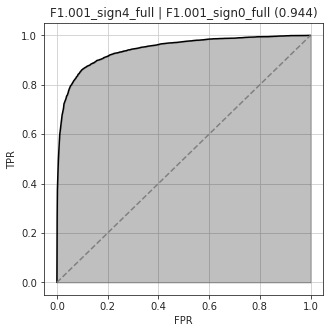

In [40]:
# sign3 and MFP do not have the same nr of molecules. This might give bad sign0 recap. Look at recap:
diag4 = sign4.diagnosis()
diag4.cross_roc(sign0, save=True, plot=True)

In [7]:
# open the image to change color and save 
cross_roc = open('/aloy/home/eviesi/APDB_space/cc_local/full/F/F1/F1.001/sign4/diags/cc_local_sign0/cross_roc_F1.001_sign0_full.pkl', 'rb')
results = pickle.load(cross_roc)
results

{'fpr': array([0.00000000e+00, 6.79440141e-04, 6.79440141e-04, ...,
        9.98233456e-01, 9.98233456e-01, 1.00000000e+00]),
 'tpr': array([0.        , 0.12433755, 0.12460932, ..., 0.99972822, 1.        ,
        1.        ]),
 'auc': 0.9442640267273413,
 'precision': array([0.50044203, 0.50037407, 0.50040811, ..., 0.99457701, 0.99456522,
        1.        ]),
 'recall': array([1.        , 0.99972822, 0.99972822, ..., 0.12460932, 0.12433755,
        0.        ]),
 'average_precision_score': 0.9507364855310341}

In [1]:
# save results 
alpha=0.25
step = 0.001

fig, ax = plt.subplots(1, 1, figsize=(5, 5))
fpr = np.arange(0, 1 + step, step)
tpr = np.interp(fpr, results["fpr"], results["tpr"])
color = "#d04cf4"
ax.plot(fpr, tpr, color=color)
ax.plot([0, 1], [0, 1], color="gray", linestyle="--")
ax.fill_between(fpr, tpr, color=color, alpha=alpha)
ax.set_xlim(-0.05, 1.05)
ax.set_ylim(-0.05, 1.05)
ax.set_xlabel("FPR")
ax.set_ylabel("TPR")
ax.set_title("F1.001_sign4_full | F1.001_sign0_full (" + str(round(results['auc'],3)) + ")")
plt.savefig('/aloy/home/eviesi/plots/APDB_spaces_plots/cross_roc_F1_sign4_sign0', dpi=600)

In [41]:
# look at keys intersection of sign4 and sign0
len(list(set(sign0.keys) & set(sign4.keys))) 

1826

### Try to run again sign4 to look at canvas plots (CC recapitulation of chemistry)

In [7]:
DATASET = "F1.002"

In [9]:
# get sign0
sign0_merge = cc_local.signature(DATASET, 'sign0')
sign0_merge.shape

(1010200, 2048)

In [8]:
# get sign3
sign3 = cc_local.signature(DATASET, 'sign3')
sign3.shape

(1010200, 128)

In [10]:
# check if the order of the keys in sign0 merge and sign3 is the same
list(sign0_merge.keys) == list(sign3.keys)

True

In [18]:
sign4 = cc_local.signature(DATASET, 'sign4')
#sign4.clear_all()
# this method is fitting a model that uses Morgan fingerprint as features to predict signature 3
#sign4.fit_hpc(sign0_merge, sign3, None, True, False, cpu=32)
sign4.shape

(1010200, 128)

[INFO    ] Loading faiss with AVX2 support.
[INFO    ] Successfully loaded faiss with AVX2 support.
[INFO    ] Removing near duplicates.
[INFO    ] Size before removing: 1010200
[INFO    ] Size after removing: 927988


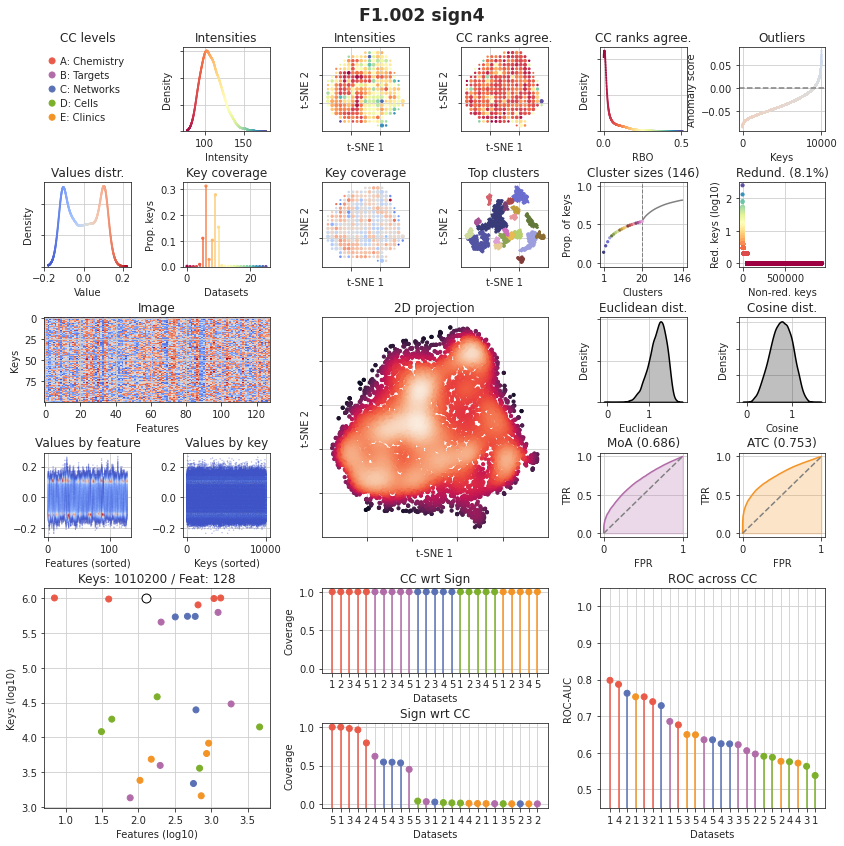

In [9]:
diag4 = sign4.diagnosis() 
diag4.canvas_medium()    # IDENTICAL!

In [10]:
# get sign0
sign0 = cc_local.signature('F1.001', 'sign0')
sign0.shape

(1826, 3886)

<AxesSubplot:title={'center':'F1.002_sign4_full | F1.001_sign0_full (0.947)'}, xlabel='FPR', ylabel='TPR'>

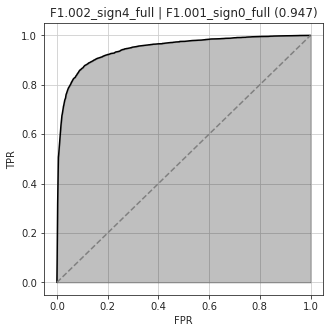

In [11]:
# sign3 and MFP do not have the same nr of molecules. This might give bad sign0 recap. Look at recap:
diag4.cross_roc(sign0, save=False, plot=True)

#### Compare with chemistry spaces A1, A3, A4, A5

In [74]:
# get F1 sign0 having APDB keys 
sign0_F1 = cc_local.signature('Q1.001', 'sign0')
sign0_F1.shape

(1826, 23)

In [75]:
# get sign0 of A1 only for APDB molecules 
sign4_A1 = cc_local.signature('A5.001', 'sign4')
sign4_A1.shape

(1009293, 128)

In [76]:
len(set(sign0_F1.keys) & set(sign4_A1.keys))

919

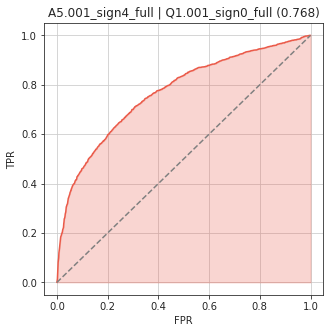

In [77]:
diag4 = sign4_A1.diagnosis()
diag4.cross_roc(sign0_F1, save=True, plot=True)
plt.savefig('/aloy/home/eviesi/plots/APDB_spaces_plots/cross_roc_A5_Q1_sign4_sign0_full', dpi=600)